3D Photo Inpainting - Turn Any Picture Into 3D Photo with Deep Learning and Python

In [ ]:
!nvidia-smi

Sat May 30 06:53:27 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.82       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [ ]:
!pip install -q vispy==0.6.4
!pip install -q moviepy==1.0.2
!pip install -q transforms3d==0.3.1
!pip install -q networkx==2.3
!pip install -q -U watermark

     |████████████████████████████████| 2.3MB 3.5MB/s 
     |████████████████████████████████| 890kB 30.8MB/s 
     |████████████████████████████████| 7.9MB 3.0MB/s 
     |████████████████████████████████| 3.3MB 34.0MB/s 
     |████████████████████████████████| 26.9MB 111kB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
     |████████████████████████████████| 71kB 2.4MB/s 
     |████████████████████████████████| 1.8MB 3.5MB/s 
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.


In [ ]:
%reload_ext watermark
%watermark -v -p torch,vispy,moviepy,transforms3d,networkx

CPython 3.6.9
IPython 5.5.0

torch 1.5.0+cu101
vispy 0.6.4
moviepy 0.2.3.5
transforms3d 0.3.1
networkx 2.4


In [ ]:
from IPython.display import HTML
from base64 import b64encode

def show_inpainting(image_file, video_file):
  image_content = open(image_file, 'rb').read()
  video_content = open(video_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  video_data = "data:video/mp4;base64," + b64encode(video_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <video height=756 controls loop>
        <source src={video_data} type='video/mp4'>
  </video>
  """)
  return html

def show_depth_estimation(image_file, depth_file):
  image_content = open(image_file, 'rb').read()
  depth_content = open(depth_file, 'rb').read()
  image_data = "data:image/jpg;base64," + b64encode(image_content).decode()
  depth_data = "data:image/png;base64," + b64encode(depth_content).decode()
  html = HTML(f"""
  <img height=756 src={image_data} />
  <img height=756 src={depth_data} />
  """)
  return html


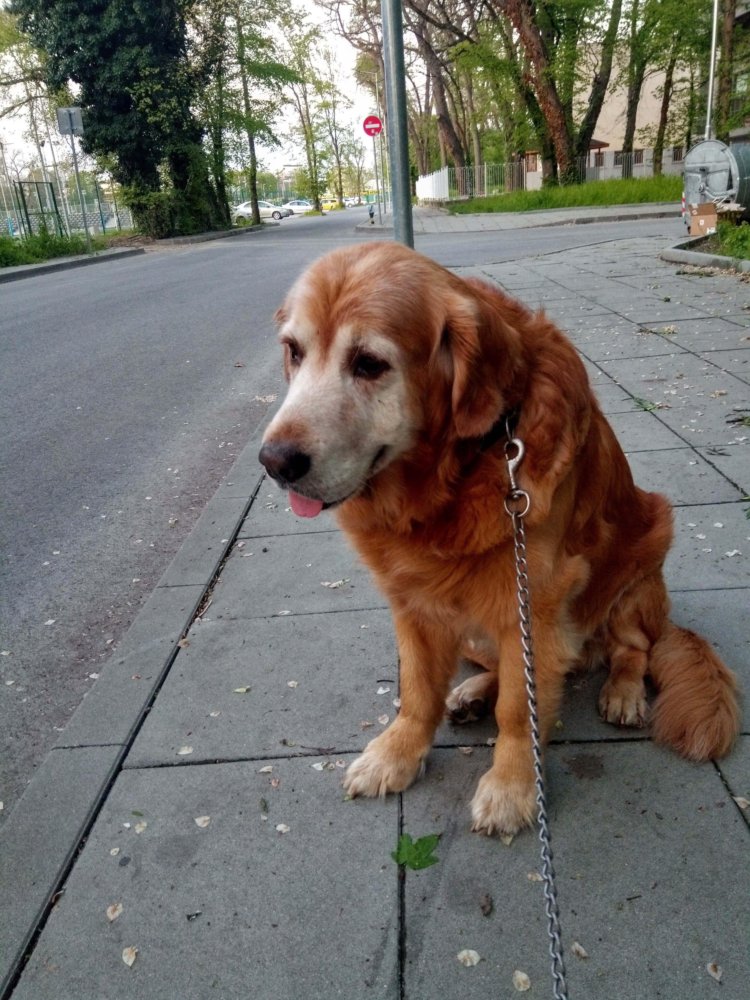

In [ ]:
!mkdir demo
!gdown -q --id 1VDT5YhANPJczevyhTdasJO5Zexl2l_fd -O demo/dog.jpg
!gdown -q --id 1CAsRBub83ptC_zPWFRZIDQDU47tFy_ST -O demo/dog-inpainting.mp4

show_inpainting('demo/dog.jpg', 'demo/dog-inpainting.mp4')

In [ ]:
%cd /content/
!git clone https://github.com/vt-vl-lab/3d-photo-inpainting.git
%cd 3d-photo-inpainting
!git checkout e804c1cb2fd695be50946db2f1eb17134f6d1b38
!sh download.sh

/content
Cloning into '3d-photo-inpainting'...
remote: Enumerating objects: 344, done.
remote: Total 344 (delta 0), reused 0 (delta 0), pack-reused 344
Receiving objects: 100% (344/344), 130.13 MiB | 32.12 MiB/s, done.
Resolving deltas: 100% (189/189), done.
/content/3d-photo-inpainting
Note: checking out 'e804c1cb2fd695be50946db2f1eb17134f6d1b38'.

You are in 'detached HEAD' state. You can look around, make experimental
changes and commit them, and you can discard any commits you make in this
state without impacting any branches by performing another checkout.

If you want to create a new branch to retain commits you create, you may
do so (now or later) by using -b with the checkout command again. Example:

  git checkout -b <new-branch-name>

HEAD is now at e804c1c Manually edited depth map.
--2020-06-14 13:31:08--  https://filebox.ece.vt.edu/~jbhuang/project/3DPhoto/model/color-model.pth
Resolving filebox.ece.vt.edu (filebox.ece.vt.edu)... 128.173.88.43
Connecting to filebox.ece.vt.

In [ ]:
!rm depth/*
!rm image/*
!rm video/*

In [ ]:
!gdown --id 1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z -O config.yml
!gdown --id 1TYmKRP4387hjDMFfWaeqcOVY7do-m0LE -O image/castle.jpg
!gdown --id 1VDT5YhANPJczevyhTdasJO5Zexl2l_fd -O image/dog.jpg

Downloading...
From: https://drive.google.com/uc?id=1b4MjYo_D5sps8F6JmYnomandLyQhjo6Z
To: /content/3d-photo-inpainting/config.yml
100% 1.22k/1.22k [00:00<00:00, 1.05MB/s]
Downloading...
From: https://drive.google.com/uc?id=1TYmKRP4387hjDMFfWaeqcOVY7do-m0LE
To: /content/3d-photo-inpainting/image/castle.jpg
2.36MB [00:00, 79.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1VDT5YhANPJczevyhTdasJO5Zexl2l_fd
To: /content/3d-photo-inpainting/image/dog.jpg
3.06MB [00:00, 94.9MB/s]


In [ ]:
!cat config.yml

depth_edge_model_ckpt: checkpoints/edge-model.pth
depth_feat_model_ckpt: checkpoints/depth-model.pth
rgb_feat_model_ckpt: checkpoints/color-model.pth
MiDaS_model_ckpt: MiDaS/model.pt
fps: 40
num_frames: 240
x_shift_range: [0.00, 0.00, -0.02, -0.02]
y_shift_range: [0.00, 0.00, -0.02, -0.00]
z_shift_range: [-0.05, -0.05, -0.07, -0.07]
traj_types: ['double-straight-line', 'double-straight-line', 'circle', 'circle']
video_postfix: ['dolly-zoom-in', 'zoom-in', 'circle', 'swing']
specific: ''
longer_side_len: 960
src_folder: image
depth_folder: depth
mesh_folder: mesh
video_folder: video
load_ply: False
save_ply: True
inference_video: True
gpu_ids: 0
offscreen_rendering: False
img_format: '.jpg'
depth_format: '.npy'
require_midas: True
depth_threshold: 0.04
ext_edge_threshold: 0.002
sparse_iter: 5
filter_size: [7, 7, 5, 5, 5]
sigma_s: 4.0
sigma_r: 0.5
redundant_number: 12
background_thickness: 70
context_thickness: 140
background_thickness_2: 70
context_thickness_2: 70
discount_factor: 1.00


In [ ]:
!python main.py --config config.yml

running on device 0
  0% 0/3 [00:00<?, ?it/s]Current Source ==>  moon
Running depth extraction at 1590644508.3205004
initialize
device: cpu
start processing
  processing image/moon.jpg (1/1)
torch.Size([1, 3, 384, 384])
finished
Start Running 3D_Photo ...
Loading edge model at 1590644527.4762554
Loading depth model at 1590644536.1686625
Loading rgb model at 1590644537.0900998
Writing depth ply (and basically doing everything) at 1590644537.987567
Writing mesh file mesh/moon.ply ...
Making video at 1590644725.6786122
fov: 53.13010235415598
Moviepy - Building video video/moon_dolly-zoom-in.mp4.
Moviepy - Writing video video/moon_dolly-zoom-in.mp4

  0% 0/3 [04:20<?, ?it/s]
t:   0% 0/241 [00:00<?, ?it/s, now=None]
t:   1% 2/241 [00:00<00:37,  6.34it/s, now=None]
t:   1% 3/241 [00:00<00:34,  6.90it/s, now=None]
t:   6% 14/241 [00:00<00:23,  9.59it/s, now=None]
t:  10% 23/241 [00:00<00:16, 13.09it/s, now=None]
t:  15% 35/241 [00:00<00:11, 17.83it/s, now=None]
t:  18% 44/241 [00:00<00:08, 23


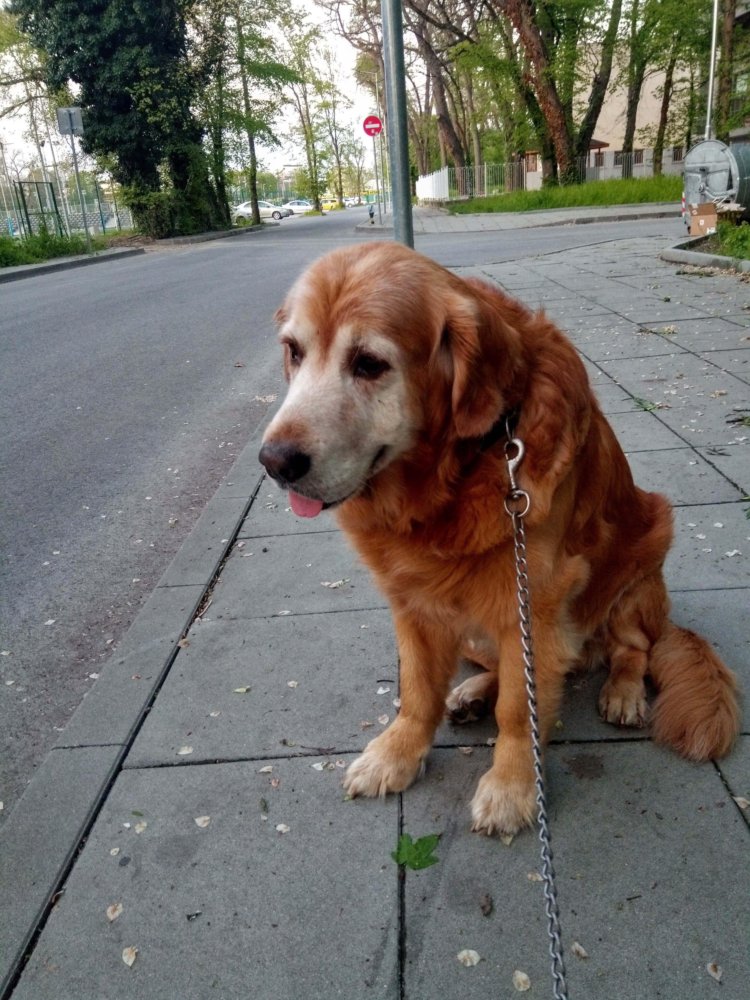
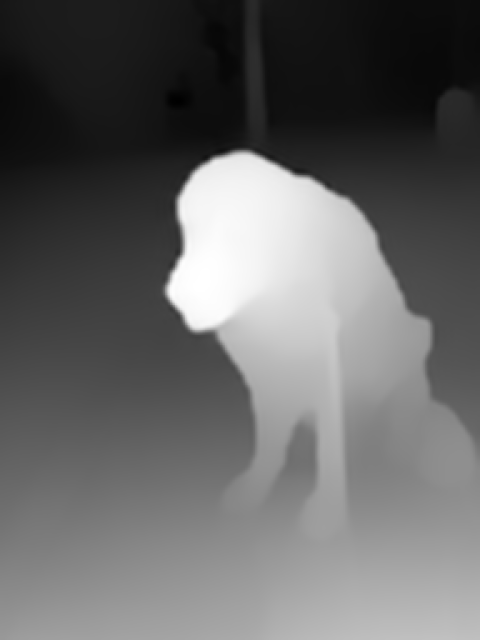

In [ ]:
show_depth_estimation('image/dog.jpg', 'depth/dog.png')


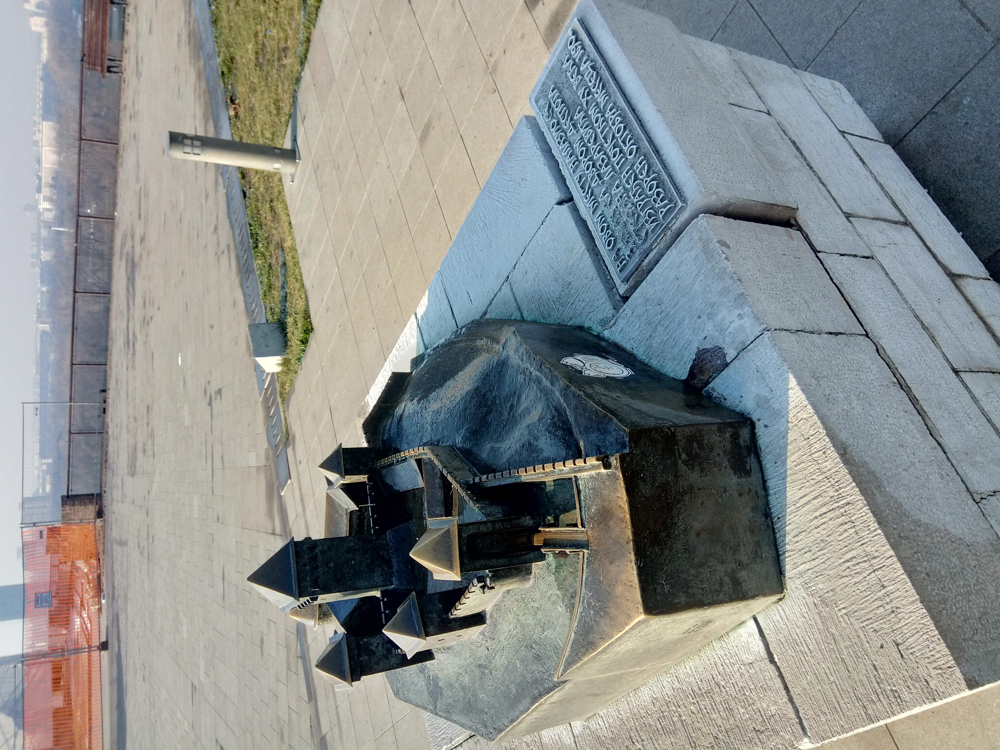
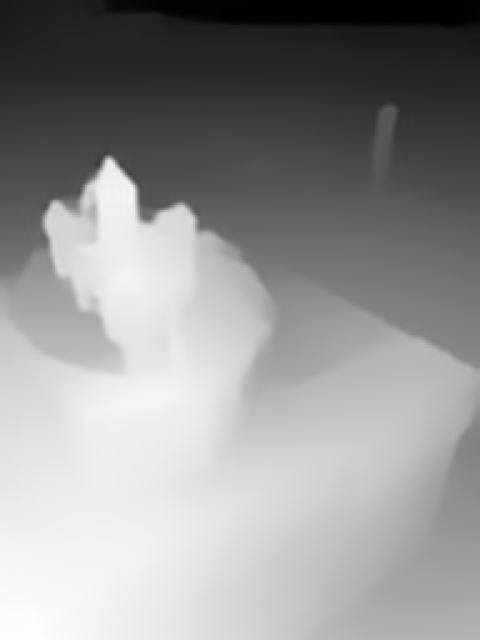

In [ ]:
show_depth_estimation('image/castle.jpg', 'depth/castle.png')


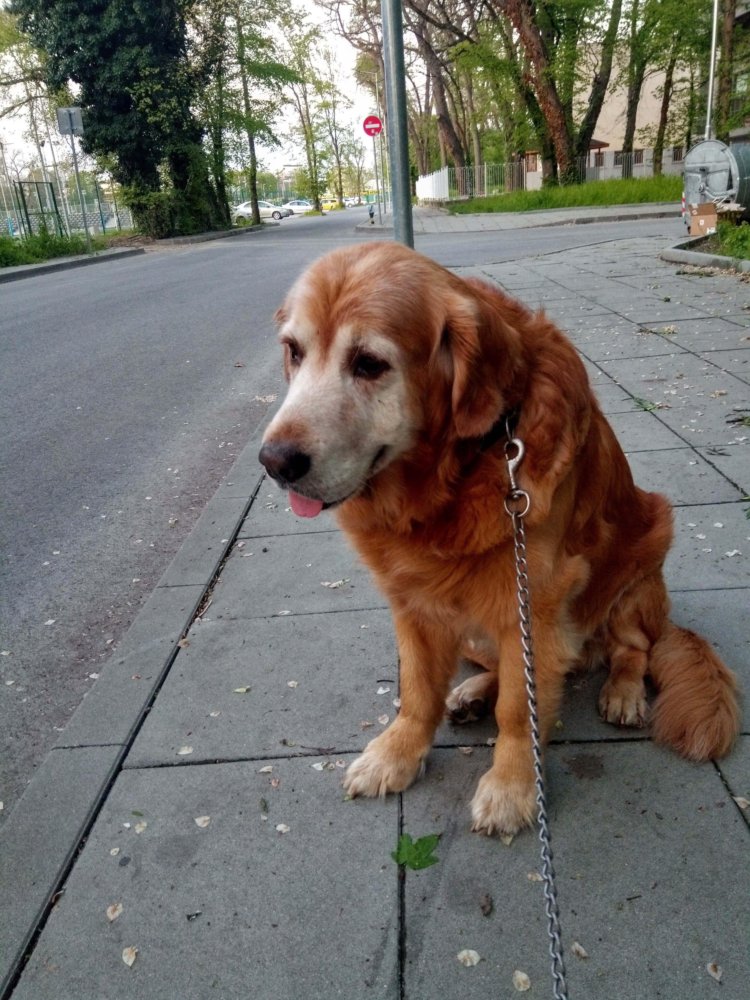

In [ ]:
show_inpainting('image/dog.jpg', 'video/dog_swing.mp4')


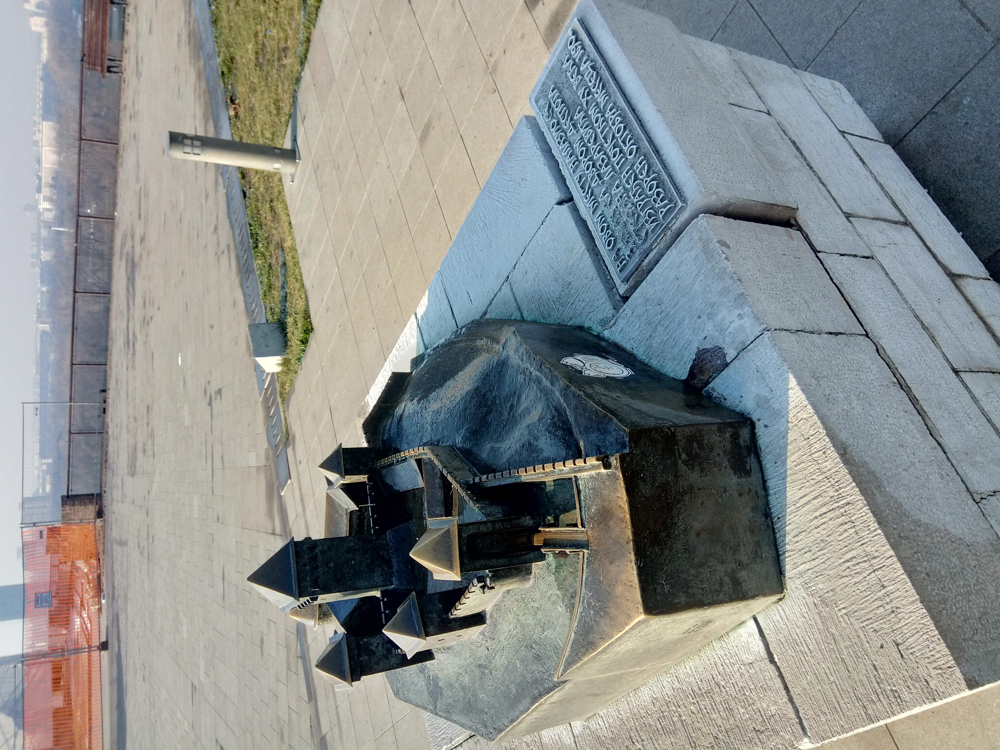

In [ ]:
show_inpainting('image/castle.jpg', 'video/castle_circle.mp4')